# Image Augmentation for Shihao

In [2]:
import os
import math

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import scipy, scipy.io
import h5py
import skimage.transform, skimage.io
import monai

import torch
import torchvision.transforms as T
from torch.nn import functional as F

import maths

In [58]:
class Vol2PatchDataTransform(object):
    """
    Apply random Rician noise to volume samples, normalise the data and convert
    them to Tensors.
    Args:
        norm (str)
    Returns:
        torch.Tensor: data
        torch.Tensor: target
    """
    def __init__(self, noise_std: float = 0.1, norm = 'minmax', aug: bool = False):
        self.noise = monai.transforms.RandRicianNoise(prob=1.0, std=noise_std, relative=True, channel_wise=True, sample_std=False)
        self.norm = norm
        self.aug = aug

    def __call__(self, data, target, noise_seed):
        data = torch.from_numpy(data)
        target = torch.from_numpy(target)

        target = target.unsqueeze(0) ## torch.from_numpy, unsqueeze(0) ??
        data_input = torch.stack((data, data))
        self.noise.set_random_state(noise_seed) ## monai.transforms.RandRicianNoise, set_random_state(noise_seed) ??
        data_input = self.noise(data_input)

        if self.norm == 'zscore':
            data_input, mean, std = maths.zscore_norm_t(data_input, 1e-11)
            target, _, _ = maths.zscore_norm_t(target, 1e-11)
            
            data_input = data_input.clamp(-2, 6)
            target = target.clamp(-2, 6)
        elif self.norm == 'minmax':
            data_input = maths.minmax_norm_t(data_input)
            target = maths.minmax_norm_t(target)
            
        if self.aug: pass

        return data_input.float(), target.float()

In [28]:
## This is the function you can work with

class Vol2PatchDataTransform_Custom(object):
    """
    Apply random Rician noise to volume samples, normalise the data and convert
    them to Tensors.
    Image Augmentation Applied, involving 
    rotation, translation, (in 3D?)
    Blending of T1w and T2w,
    Cutout
    CutMix
    
    Args:
        norm (str)
    Returns:
        torch.Tensor: data
        torch.Tensor: target
    """
    def __init__(self, noise_std: float=0.1, norm='minmax', aug: bool = False):
        self.noise = monai.transforms.RandRicianNoise(prob=1.0, std=noise_std, relative=True, channel_wise=True, sample_std=False)
        self.norm = norm
        self.aug = aug

    def aug_rotate_torchvision(self, data, degree):
        '''
        use rotate in torch vision, rotate the last two dimension
        '''
        interpolation = T.functional.InterpolationMode.BILINEAR
        return T.functional.rotate(data, degree, interpolation)
    
    def aug_transform(self, img, degree, H, V, padding='zeros'):
        '''
        degree: counter-clockwise in int:degree, 
        H: Horizontal translation in float:(-1, 1[left]), 
        V: Vertical translation in float:(-1, 1[up])
        padding: 'zeros' 'border' 'reflection'
        '''
        angle = degree*math.pi/180
        theta = torch.tensor([
        [math.cos(angle),math.sin(-angle),H],
        [math.sin(angle),math.cos(angle) ,V]
        ], dtype=torch.float)
        
        print(img.size())

        N, C, W, H = img.size()
        size = torch.Size((1, C, W, H))
        #print(size)

        grid = F.affine_grid(theta.unsqueeze(0), size)
        if img.dtype == torch.float64:
            grid = grid.double()
        output = F.grid_sample(img[0].unsqueeze(0), grid, padding_mode=padding)
        #print(output.size())
        return output[0]        
    
    def __call__(self, data, target, noise_seed):
        data = np.transpose(data, (2,0,1))
        target = np.transpose(target, (2,0,1))
        
        data = torch.from_numpy(data)
        target = torch.from_numpy(target)

        target = target.unsqueeze(0)
        data_input = torch.stack((data, data))
        self.noise.set_random_state(noise_seed)
        data_input = self.noise(data_input)

        if self.norm == 'zscore':
            data_input, mean, std = maths.zscore_norm_t(data_input, 1e-11)
            target, _, _ = maths.zscore_norm_t(target, 1e-11)
            
            data_input = data_input.clamp(-2, 6)
            target = target.clamp(-2, 6)
        elif self.norm == 'minmax':
            data_input = maths.minmax_norm_t(data_input)
            target = maths.minmax_norm_t(target)
            
        if self.aug:
            data_input = self.aug_transform(data_input, 90, 0, 0) # degree, H, V
            target = self.aug_transform(target, 90, 0, 0)
            
            #data_input = self.aug_rotate_torchvision(data_input, 70)
            #target = self.aug_rotate_torchvision(target, 70)
            
        data_input = data_input.permute(1,2,0)
        target = target.permute(1,2,0)
        return data_input.float(), target.float()
    

In [26]:
def visualise_img(image, fig_size=(4, 8), res=200):
    fig = plt.figure(dpi=res)
    grid = ImageGrid(fig, 111, nrows_ncols=fig_size, axes_pad=0.0)
    for i in range(image.shape[-1]):
        #grid[i].imshow(np.rot90(image[i, ...], 1), cmap='gray')
        grid[i].imshow(image[..., i], cmap='gray')
        grid[i].axis('off')
        grid[i].set_xticks([])
        grid[i].set_yticks([])
    plt.show()

In [37]:
def visualise_sideview(image, grid_num, fig_size, res=200):
    
    if grid_num != fig_size[0]*fig_size[1]:
        return
    
    image = F.interpolate(image, size=grid_num, mode='linear', align_corners=None)
    print(image.size())
    
    fig = plt.figure(dpi=res)
    grid = ImageGrid(fig, 111, nrows_ncols=fig_size, axes_pad=0.0)
    for i in range(grid_num):
        #grid[i].imshow(np.rot90(image[i, ...], 1), cmap='gray')
        grid[i].imshow(image[i, ...], cmap='gray')
        grid[i].axis('off')
        grid[i].set_xticks([])
        grid[i].set_yticks([])
    plt.show()

## Visualisation of data

### T2w

In [12]:
# data file name
fname = '101915_3T_T2w_SPC1'

In [13]:
# Load data
with h5py.File(os.path.join('data', fname+'.h5')) as f:
    x = f['data'][()]
    y = f['target'][()]
    
print('Shape of x (input, Low Res) =', x.shape)
print('Shape of y (target, High Res) =', y.shape)

Shape of x (input, Low Res) = (128, 128, 32)
Shape of y (target, High Res) = (256, 256, 64)


In [16]:
transform = Vol2PatchDataTransform(noise_std=0.1, aug=False)

NameError: name 'Vol2PatchDataTransform' is not defined

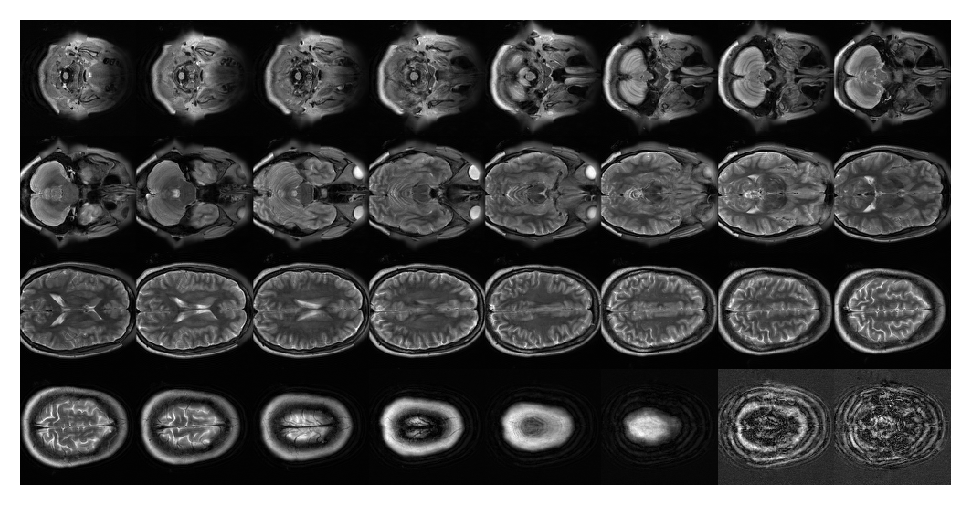

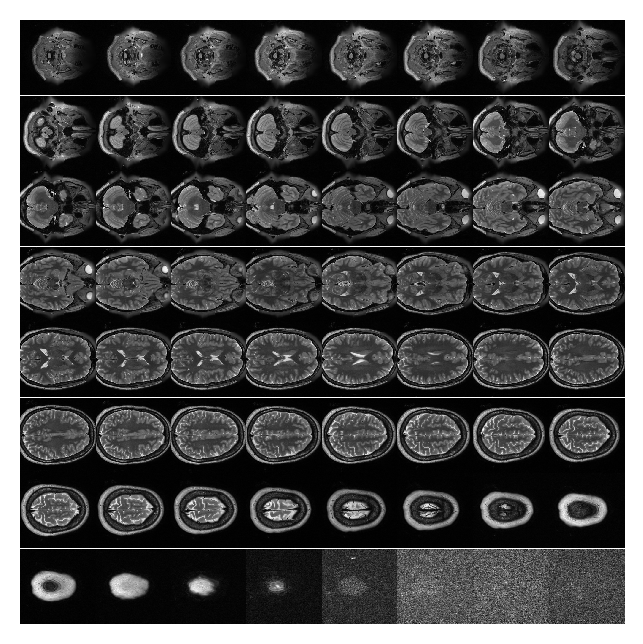

In [17]:
visualise_img(x, (4, 8))
visualise_img(y, (8, 8))

#### After transformation, adding some noise

Shape of augmented x (input, Low Res) = torch.Size([2, 128, 128, 32])


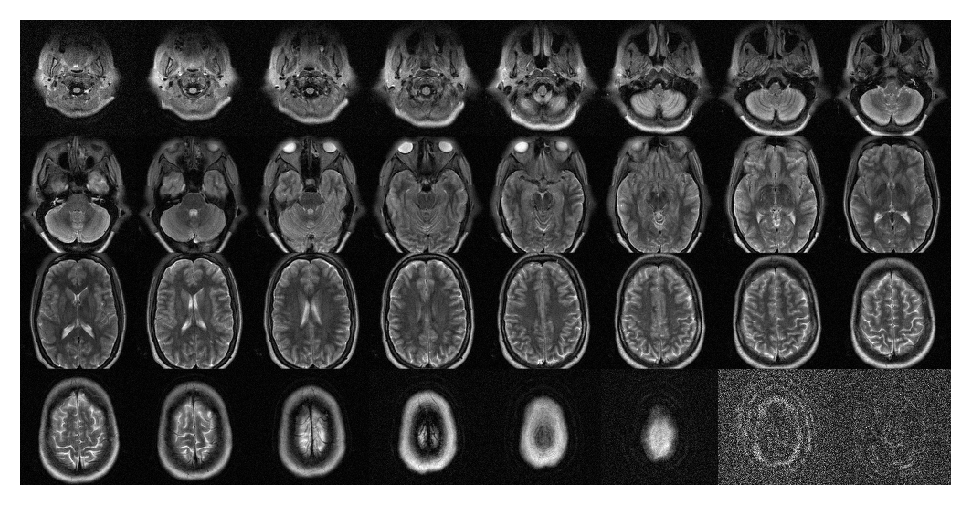

In [41]:
x_t, _ = transform(x, y, 0)
print('Shape of augmented x (input, Low Res) =', x_t.shape) # ignore first dimension
visualise_img(x_t[0, ...], (4, 8))

### T1w

In [42]:
# data file name
fname1 = '139435_3T_T1w_MPR1'

In [43]:
# Load data
with h5py.File(os.path.join('data', fname1+'.h5')) as f:
    x1 = f['data'][()]
    y1 = f['target'][()]

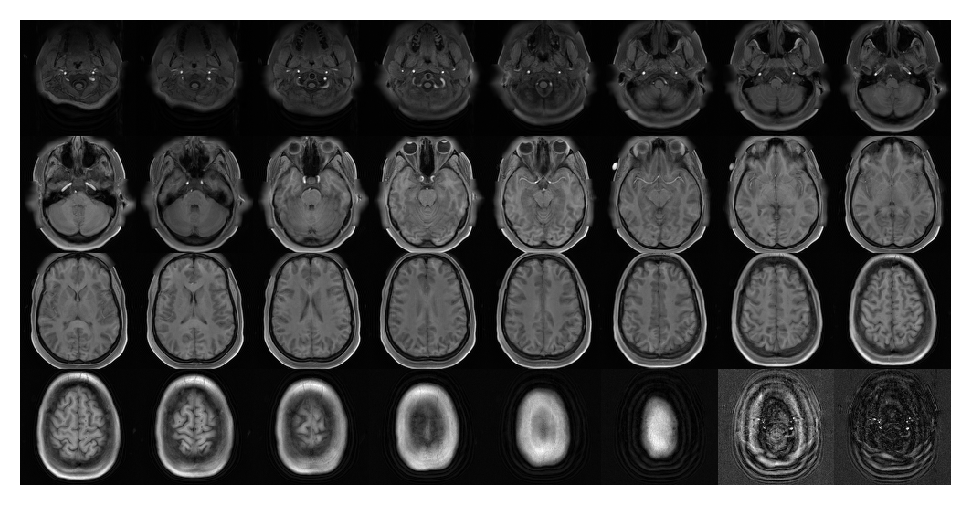

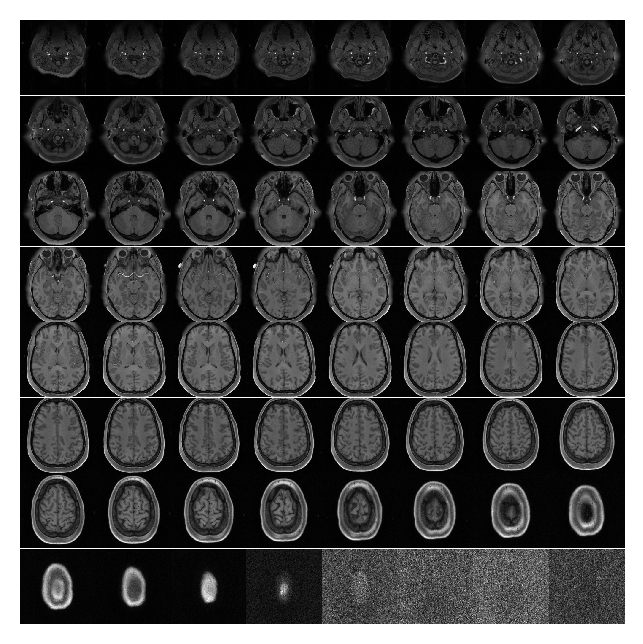

In [44]:
visualise_img(x1)
visualise_img(y1, (8, 8))

## Test your code here

In [6]:
# data file name
fname = '101915_3T_T2w_SPC1'
# Load data
with h5py.File(os.path.join('data', fname+'.h5')) as f:
    x = f['data'][()]
    y = f['target'][()]
print('Shape of x (input, Low Res) =', x.shape)
print('Shape of y (target, High Res) =', y.shape)

Shape of x (input, Low Res) = (128, 128, 32)
Shape of y (target, High Res) = (256, 256, 64)


In [29]:
transform = Vol2PatchDataTransform_Custom(noise_std=0.1, aug=True)
x_t, y_t = transform(x, y, 0)
print('Shape of augmented x (input, Low Res) =', x_t.shape)
print('Shape of augmented y (input, Low Res) =', y_t.shape)

torch.Size([2, 32, 128, 128])
torch.Size([1, 64, 256, 256])
Shape of augmented x (input, Low Res) = torch.Size([128, 128, 32])
Shape of augmented y (input, Low Res) = torch.Size([256, 256, 64])


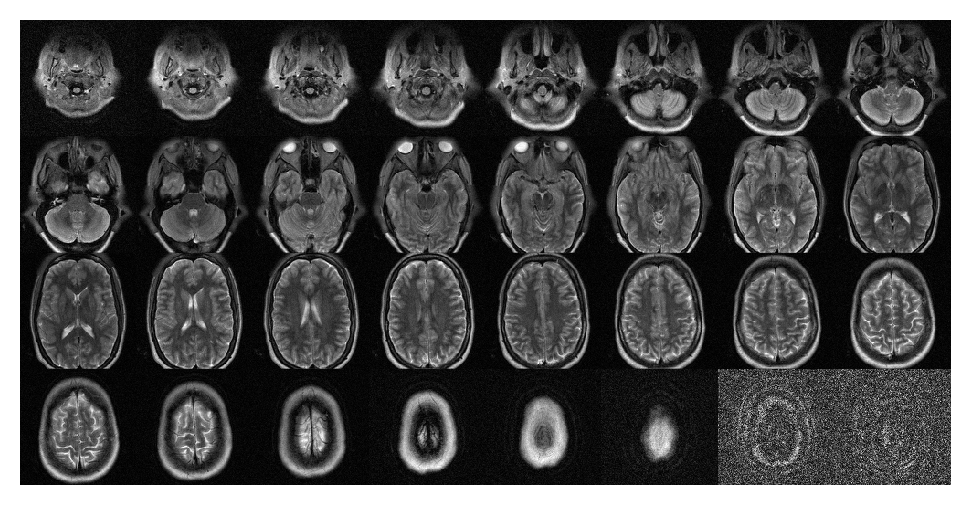

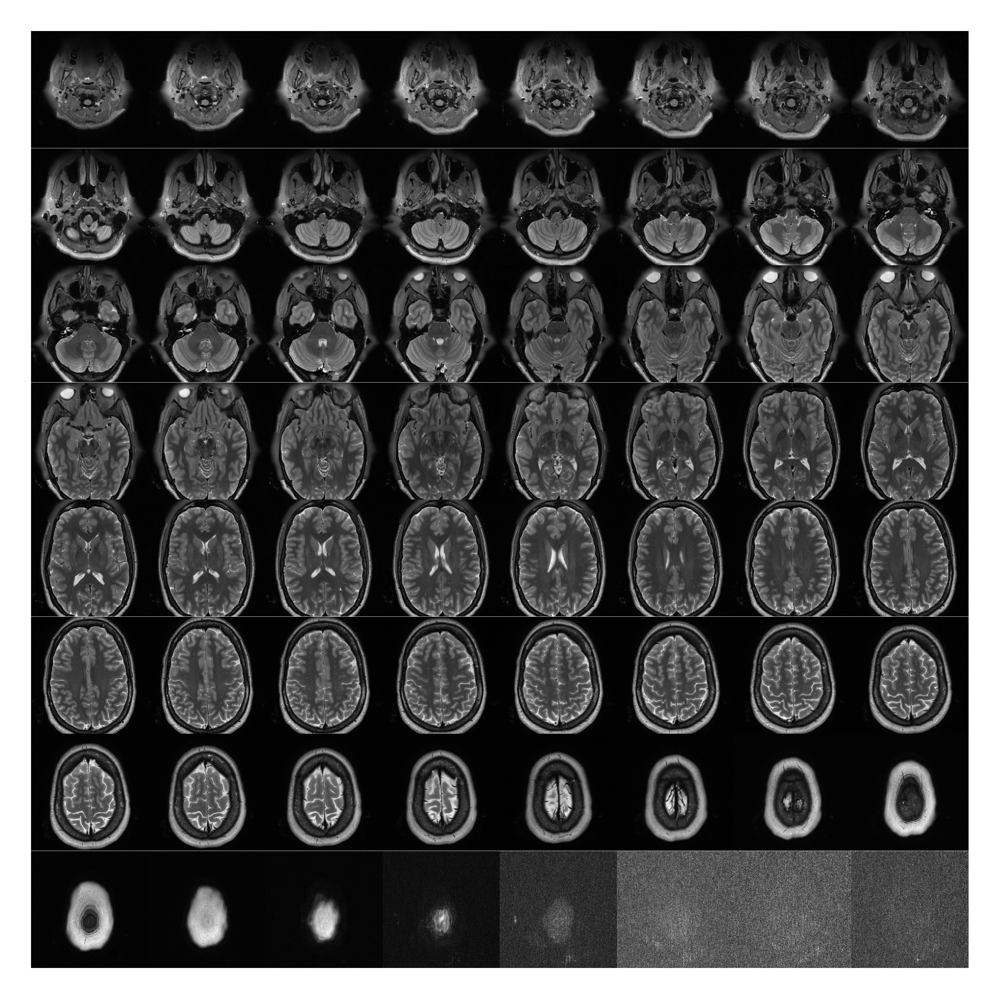

In [31]:
visualise_img(x_t, (4, 8))
visualise_img(y_t, (8, 8), res=1000)

torch.Size([256, 256, 256])


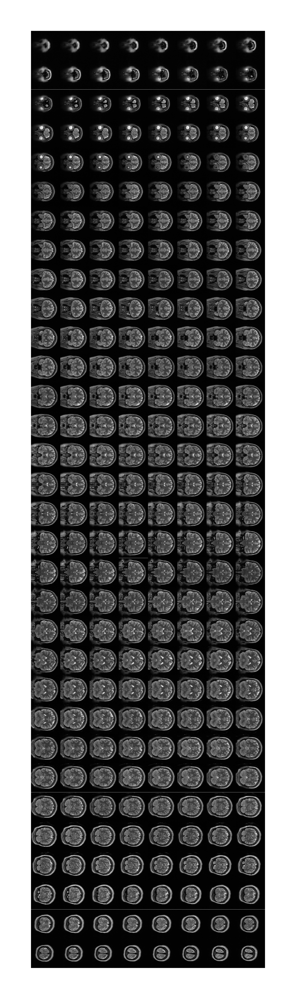

In [38]:
visualise_sideview(y_t, 256, (32, 8), res = 2000)